In [1]:
def gel_image_processing(gel_num, gels):

    import numpy as np
    import scipy.ndimage as ndi
    from scipy import io
    import matplotlib.pyplot as plt
    from skimage.filters import sobel
    import math
    import pandas as pd

    #Load in UVP data and gel metadata
    SKQ201915s_mean_conc_50m_norm = io.loadmat('G:/Cruises/2019_LTER_NGA_Summer/SKQ201915S_gel_images/SKQ201915s_mean_conc_50m_norm.mat')
    SKQ201915s_mean_conc_50m_norm_values = list(SKQ201915s_mean_conc_50m_norm.values())
    SKQ201915s_mean_conc_50m_norm_array = np.array(SKQ201915s_mean_conc_50m_norm_values[3])
    #print(SKQ201915s_mean_conc_15m_norm_array[0,0])
    
    SKQ201915s_Num_Part_Conc = io.loadmat('G:/Cruises/2019_LTER_NGA_Summer/SKQ201915S_gel_images/SKQ201915s_Num_Part_Conc.mat')
    SKQ201915s_Num_Part_Conc_values = list(SKQ201915s_Num_Part_Conc.values())
    SKQ201915s_Num_Part_Conc_array = np.array(SKQ201915s_Num_Part_Conc_values[3])
    #print(SKQ201915s_Num_Part_Conc_array[0,0])
    
    SKQ201915s_cmperpixel_pixels_per_cm = io.loadmat('G:/Cruises/2019_LTER_NGA_Summer/SKQ201915S_gel_images/SKQ201915s_cmperpixel_pixels_per_cm.mat')
    SKQ201915s_cmperpixel_pixels_per_cm_values = list(SKQ201915s_cmperpixel_pixels_per_cm.values())
    SKQ201915s_cmperpixel_pixels_per_cmarray = np.array(SKQ201915s_cmperpixel_pixels_per_cm_values[3])
    #print(SKQ201915s_cmperpixel_pixels_per_cmarray[0,0])

    SKQ201915s_Days_Collecting = io.loadmat('G:/Cruises/2019_LTER_NGA_Summer/SKQ201915S_gel_images/SKQ201915s_Days_Collecting.mat')
    SKQ201915s_Days_Collecting_values = list(SKQ201915s_Days_Collecting.values())
    SKQ201915s_Days_Collecting_array = np.array(SKQ201915s_Days_Collecting_values[3])
    #print(SKQ201915s_Days_Collecting_array[0,0])

    SKQ201915s_Image_Number_Path = io.loadmat('G:/Cruises/2019_LTER_NGA_Summer/SKQ201915S_gel_images/SKQ201915s_Image_Number_Path.mat')
    SKQ201915s_Image_Number_Path_values = list(SKQ201915s_Image_Number_Path.values())
    SKQ201915s_Image_Number_Path_array = np.array(SKQ201915s_Image_Number_Path_values[3])
    #print(SKQ201915s_Image_Number_Path_array[0,0])

    SKQ201915s_Path_Python = io.loadmat('G:/Cruises/2019_LTER_NGA_Summer/SKQ201915S_gel_images/SKQ201915s_Path_Python.mat')
    SKQ201915s_Path_Python_values = list(SKQ201915s_Path_Python.values())
    SKQ201915s_Path_Python_array = np.array(SKQ201915s_Path_Python_values[3])
    #print(SKQ201915s_Path_Python_array[0,0])

    SKQ201915s_Station_Name = io.loadmat('G:/Cruises/2019_LTER_NGA_Summer/SKQ201915S_gel_images/SKQ201915s_Station_Name.mat')
    SKQ201915s_Station_Name_values = list(SKQ201915s_Station_Name.values())
    SKQ201915s_Station_Name_array = np.array(SKQ201915s_Station_Name_values[3])
    #print(SKQ201915s_Station_Name_array[0,0])

    SKQ201915s_Trap_depth = io.loadmat('G:/Cruises/2019_LTER_NGA_Summer/SKQ201915S_gel_images/SKQ201915s_Trap_depth.mat')
    SKQ201915s_Trap_depth_values = list(SKQ201915s_Trap_depth.values())
    SKQ201915s_Trap_depth_array = np.array(SKQ201915s_Trap_depth_values[3])
    #print(SKQ201915s_Trap_depth_array[0,0])

    SKQ201915s_Tube_Number = io.loadmat('G:/Cruises/2019_LTER_NGA_Summer/SKQ201915S_gel_images/SKQ201915s_Tube_Number.mat')
    SKQ201915s_Tube_Number_values = list(SKQ201915s_Tube_Number.values())
    SKQ201915s_Tube_Number_array = np.array(SKQ201915s_Tube_Number_values[3])
    #print(SKQ201915s_Tube_Number_array[0,0])

    #gel_num = 28
    SKQ201915s_Path_Python_str = str(SKQ201915s_Path_Python_array[gel_num,0])
    SKQ201915s_Image_Number_Path_str= str(SKQ201915s_Image_Number_Path_array[gel_num,0])
    SKQ201915s_Station_Name_str = str(SKQ201915s_Station_Name_array[gel_num,0])
    SKQ201915s_Tube_Number_str=str(SKQ201915s_Tube_Number_array[gel_num,0])
    SKQ201915s_Days_Collecting_num= SKQ201915s_Days_Collecting_array[gel_num,0]
    SKQ201915s_cmperpixel_pixels_per_cm_num = SKQ201915s_cmperpixel_pixels_per_cmarray[gel_num,0]
    SKQ201915s_mean_conc_50m_norm_num = SKQ201915s_mean_conc_50m_norm_array[gel_num,:]
    SKQ201915s_Trap_depth_num = SKQ201915s_Trap_depth_array[gels,0]
    SKQ201915s_Num_Part_Conc_num = SKQ201915s_Num_Part_Conc_array[gel_num,:]
    #print(SKQ201915s_Path_Python_str[2:-2])
    #print(SKQ201915s_Image_Number_Path_str[2:-2])
    #print(SKQ201915s_Station_Name_str[2:-2])
    #print(SKQ201915s_Tube_Number_str[2:-2])
    
    
    #Load in image
    from skimage import io, filters, color, measure, util, morphology, exposure
    #photo = io.imread('D:/GIT/NGA_particles_flux_publication/Data/SKQ201915S_gel_images/GAK15/A1/DSC07516_crop_original.JPG',plugin='pil')
    #photo_blank = io.imread('/Users/colleen/Projects/EXPORTS/exports_images/Gels/RR65/RR65_obl/RR65_7x_obl/RR65_7x_obl_1.tiff', plugin= 'pil')
    #plt.figure()
    #plt.imshow(photo)

    #photo = io.imread('D:/GIT/NGA_particles_flux_publication/Data/SKQ201915S_gel_images/GAK15/A1/DSC07516_crop.JPG', as_gray=False)
    photo = io.imread(f'D:/GIT/NGA_particles_flux_publication/Data/SKQ201915S_gel_images/{SKQ201915s_Station_Name_str[2:-2]}/{SKQ201915s_Tube_Number_str[2:-2]}/{SKQ201915s_Image_Number_Path_str[2:-2]}_crop.JPG', as_gray=False)
    #photo = io.imread(f'{SKQ201915s_Path_Python_array[gel_num]}/{SKQ201915s_Image_Number_Path_array[gel_num]}_crop.JPG', as_gray=False)
    #photo_blank = io.imread('/Users/colleen/Projects/EXPORTS/exports_images/Gels/RR65/RR65_obl/RR65_7x_obl/RR65_7x_obl_1.tiff', plugin= 'pil')
    #plt.figure(figsize=(len(photo[0])/350, len(photo)/350), frameon = False) #,  bbox_inches = 'tight', pad_inches = 0)
    plt.figure()
    plt.imshow(photo)
    #plt.axis('off')
    #plt.imsave(f'C:/Users/Stephanie/GIT/NGA_particles_flux_publication/Plots/SKQ201915S_{SKQ201915s_Station_Name_str[2:-2]}_{SKQ201915s_Tube_Number_str[2:-2]}_{SKQ201915s_Image_Number_Path_str[2:-2]}_photo.png',dpi = 350, bbox_inches = 'tight', pad_inches = 0)
    #plt.imsave(f'D:/GIT/NGA_particles_flux_publication/Plots/SKQ201915S_{SKQ201915s_Station_Name_str[2:-2]}_{SKQ201915s_Tube_Number_str[2:-2]}_{SKQ201915s_Image_Number_Path_str[2:-2]}_photo.png', photo)
    plt.savefig(f'D:/GIT/NGA_particles_flux_publication/Plots/SKQ201915S_{SKQ201915s_Station_Name_str[2:-2]}_{SKQ201915s_Tube_Number_str[2:-2]}_{SKQ201915s_Image_Number_Path_str[2:-2]}_photo.png', dpi = 300, bbox_inches = 'tight')
    
    photo_grey1 = color.rgb2grey(photo)
    photo_grey=util.img_as_ubyte(photo_grey1)
    plt.figure()
    plt.imshow(photo_grey,cmap=plt.cm.gray)
    #plt.savefig(f'C:/Users/Stephanie/GIT/NGA_particles_flux_publication/Plots/SKQ201915S_{SKQ201915s_Station_Name_str[2:-2]}_{SKQ201915s_Tube_Number_str[2:-2]}_{SKQ201915s_Image_Number_Path_str[2:-2]}_photo_grey.png', bbox_inches = 'tight',dpi = 300)
    plt.imsave(f'D:/GIT/NGA_particles_flux_publication/Plots/SKQ201915S_{SKQ201915s_Station_Name_str[2:-2]}_{SKQ201915s_Tube_Number_str[2:-2]}_{SKQ201915s_Image_Number_Path_str[2:-2]}_photo_grey.png', photo_grey, cmap=plt.cm.gray)
    photo_red1 = photo[:,:,0]
    photo_red=util.img_as_ubyte(photo_red1)
    plt.figure()
    plt.imshow(photo_red,cmap=plt.cm.gray)
    photo_blue1 = photo[:,:,2]
    photo_blue=util.img_as_ubyte(photo_blue1)
    plt.figure()
    plt.imshow(photo_blue,cmap=plt.cm.gray)
    
    photo_brown_nobg= photo_red - photo_blue #changed 3/16/2021 from photo_red_nobg - photo_blue_nobg
    plt.figure()
    plt.imshow(photo_brown_nobg, cmap=plt.cm.gray)
    #plt.savefig(f'C:/Users/Stephanie/GIT/NGA_particles_flux_publication/Plots/SKQ201915S_{SKQ201915s_Station_Name_str[2:-2]}_{SKQ201915s_Tube_Number_str[2:-2]}_{SKQ201915s_Image_Number_Path_str[2:-2]}_brown_pixels.png', bbox_inches = 'tight',dpi = 300)
    plt.imsave(f'D:/GIT/NGA_particles_flux_publication/Plots/SKQ201915S_{SKQ201915s_Station_Name_str[2:-2]}_{SKQ201915s_Tube_Number_str[2:-2]}_{SKQ201915s_Image_Number_Path_str[2:-2]}_brown_pixels.png', photo_brown_nobg, cmap=plt.cm.gray)
    return photo_grey, photo_brown_nobg, photo_red, photo_blue, photo, SKQ201915s_Path_Python_str, SKQ201915s_Image_Number_Path_str, SKQ201915s_Station_Name_str, SKQ201915s_Tube_Number_str, SKQ201915s_cmperpixel_pixels_per_cm_num, SKQ201915s_mean_conc_50m_norm_num, SKQ201915s_Days_Collecting_num, SKQ201915s_Trap_depth_num, SKQ201915s_Num_Part_Conc_num 

In [2]:
def background_sub(photo_grey):
    import numpy as np
    from scipy.ndimage import gaussian_filter
    from skimage import img_as_float
    from skimage.morphology import reconstruction
    import matplotlib.pyplot as plt

    image = gaussian_filter(photo_grey, 1)
    plt.figure()
    plt.imshow(image, cmap='gray')
    seed = np.copy(image)
    seed[1:-1, 1:-1] = image.min()
    plt.figure()
    mask = image
    dilated = reconstruction(seed, mask, method='dilation')
    #plt.figure()
    plt.imshow(dilated, cmap='gray')
    #plt.savefig(f'C:/Users/Stephanie/GIT/NGA_particles_flux_publication/Plots/SKQ201915S_{SKQ201915s_Station_Name_str[2:-2]}_{SKQ201915s_Tube_Number_str[2:-2]}_{SKQ201915s_Image_Number_Path_str[2:-2]}_background.png', bbox_inches = 'tight',dpi = 300)
    plt.imsave(f'D:/GIT/NGA_particles_flux_publication/Plots/SKQ201915S_{SKQ201915s_Station_Name_str[2:-2]}_{SKQ201915s_Tube_Number_str[2:-2]}_{SKQ201915s_Image_Number_Path_str[2:-2]}_background.png', dilated, cmap='gray')
    photo_grey_nobg = image - dilated
    plt.figure()
    plt.imshow(photo_grey_nobg, cmap='gray')
    #plt.savefig(f'D:/GIT/NGA_particles_flux_publication/Plots/SKQ201915S_{SKQ201915s_Station_Name_str[2:-2]}_{SKQ201915s_Tube_Number_str[2:-2]}_{SKQ201915s_Image_Number_Path_str[2:-2]}_photo_grey_nobg.png', bbox_inches = 'tight',dpi = 300)
    plt.imsave(f'D:/GIT/NGA_particles_flux_publication/Plots/SKQ201915S_{SKQ201915s_Station_Name_str[2:-2]}_{SKQ201915s_Tube_Number_str[2:-2]}_{SKQ201915s_Image_Number_Path_str[2:-2]}_photo_grey_nobg.png', photo_grey_nobg, cmap='gray')
    return photo_grey_nobg

In [3]:
def early_edge_detection(photo_grey, photo_brown_nobg,edge_num):
    import numpy as np
    from skimage.filters import sobel
    import matplotlib.pyplot as plt  
    from skimage import io, filters, color, measure, util, morphology, exposure
    import scipy.ndimage as ndi
    from skimage.filters import threshold_yen
    elevation_map_grey = sobel(photo_grey)
    #elevation_map_grey[particle_erode==True]=0
    plt.figure()
    plt.imshow(elevation_map_grey)
    histo = exposure.histogram(elevation_map_grey)
    plt.figure()
    plt.plot(histo[1],histo[0])
    edges = np.zeros_like(photo_grey)
    edges[elevation_map_grey >= edge_num] = 255
    labeled_edges, _ = ndi.label(edges)
    plt.figure()
    plt.imshow(edges,cmap=plt.cm.gray)
    #plt.savefig(f'C:/Users/Stephanie/GIT/NGA_particles_flux_publication/Plots/SKQ201915S_{SKQ201915s_Station_Name_str[2:-2]}_{SKQ201915s_Tube_Number_str[2:-2]}_{SKQ201915s_Image_Number_Path_str[2:-2]}_edges.png', bbox_inches = 'tight',dpi = 300)
    #plt.imsave(f'C:/Users/Stephanie/GIT/NGA_particles_flux_publication/Plots/SKQ201915S_{SKQ201915s_Station_Name_str[2:-2]}_{SKQ201915s_Tube_Number_str[2:-2]}_{SKQ201915s_Image_Number_Path_str[2:-2]}_edges.png', edges,cmap=plt.cm.gray)
    
    #histo = exposure.histogram(photo_brown_nobg)
    #plt.figure()
    #plt.plot(histo[1],histo[0])    
    
    from skimage.filters import try_all_threshold
    from skimage.filters import threshold_otsu
    from skimage.filters import threshold_isodata
    from skimage.filters import threshold_li
    from skimage.filters import threshold_triangle
    thresh_otsu = threshold_triangle(photo_grey) #changed from photo_grey
    markers = np.zeros_like(photo_grey)# figuring out how to make background magenta +[255, 0, 255]
    markers2 = np.zeros_like(photo_grey)#$$$$$$$$$$$$$$$$$$$$$$$$$$$$$$$
    markers3 = np.zeros_like(photo_grey)#$$$$$$$$$$$$$$$$$$$$$$$$$$$$$$$
#    markers[labeled_edges >0] = 1   ###Mark edges $$$$$$$$$$$$$$$$$
#    markers_fill = ndi.morphology.binary_fill_holes(markers)#$$$$$$$$$$$$$$$$$$$
#    plt.figure()
#    plt.imshow(markers_fill, cmap=plt.cm.gray)
#    plt.savefig(f'C:/Users/Stephanie/GIT/NGA_particles_flux_publication/Plots/SKQ201915S_{SKQ201915s_Station_Name_str[2:-2]}_{SKQ201915s_Tube_Number_str[2:-2]}_{SKQ201915s_Image_Number_Path_str[2:-2]}_marker_fill_edge.png', bbox_inches = 'tight',dpi = 300)
    #markers[photo_grey <= 20] = 1     ###Mark very dark pixels in the greyscale image -- getting rid when doing background sub
    markers[photo_brown_nobg <= 200] = 1    ###Mark bright pixels in the brown image
    markers[photo_brown_nobg <= 15] = 0 
    markers3[photo_brown_nobg <= 200] = 1   #$$$$$$$$$$$$$$$$$$$  
    markers3[photo_brown_nobg <= 15] = 0 
    markers_fill = ndi.morphology.binary_fill_holes(markers)#$$$$$$$$$$$$$$$$$$$
    markers_fill3 = ndi.morphology.binary_fill_holes(markers3)#$$$$$$$$$$$$$$$$$$$

    plt.figure()#$$$$$$$$$$$$$$$$$$$
    plt.imshow(markers_fill3, cmap=plt.cm.gray)    #$$$$$$$$$$$$$$$$$$
    plt.savefig(f'D:/GIT/NGA_particles_flux_publication/Plots/SKQ201915S_{SKQ201915s_Station_Name_str[2:-2]}_{SKQ201915s_Tube_Number_str[2:-2]}_{SKQ201915s_Image_Number_Path_str[2:-2]}_marker_fill_brown.png', bbox_inches = 'tight',dpi = 300)
    markers[photo_grey >=thresh_otsu] = 1   ###Mark very bright pixels in the greyscale image #changed from photo_grey
    markers2[photo_grey >=thresh_otsu] = 1 #$$$$$$$$$$$$$$$$$$
    markers_fill2 = ndi.morphology.binary_fill_holes(markers2) 
    plt.figure()
    plt.imshow(markers_fill2, cmap=plt.cm.gray)  
    #plt.savefig(f'C:/Users/Stephanie/GIT/NGA_particles_flux_publication/Plots/SKQ201915S_{SKQ201915s_Station_Name_str[2:-2]}_{SKQ201915s_Tube_Number_str[2:-2]}_{SKQ201915s_Image_Number_Path_str[2:-2]}_marker_fill_yen.png', bbox_inches = 'tight',dpi = 300)
    markers_fill = ndi.morphology.binary_fill_holes(markers)
    
  #adding erosion step
    markers_fill = morphology.erosion(markers_fill, morphology.disk(2))
    plt.figure()
    plt.imshow(markers_fill, cmap=plt.cm.gray)
    #plt.axis('off')
    #plt.savefig(f'C:/Users/Stephanie/GIT/NGA_particles_flux_publication/Plots/SKQ201915S_{SKQ201915s_Station_Name_str[2:-2]}_{SKQ201915s_Tube_Number_str[2:-2]}_{SKQ201915s_Image_Number_Path_str[2:-2]}_markers_fill2.png', bbox_inches = 'tight',dpi = 300)

    
    labeled_particles, _ = ndi.label(markers_fill)
    plt.figure()
    plt.imshow(markers_fill, cmap=plt.cm.gray)
    #plt.axis('off')
    #plt.savefig(f'C:/Users/Stephanie/GIT/NGA_particles_flux_publication/Plots/SKQ201915S_{SKQ201915s_Station_Name_str[2:-2]}_{SKQ201915s_Tube_Number_str[2:-2]}_{SKQ201915s_Image_Number_Path_str[2:-2]}_marker_fill.png', bbox_inches = 'tight',dpi = 300)
    plt.imsave(f'D:/GIT/NGA_particles_flux_publication/Plots/SKQ201915S_{SKQ201915s_Station_Name_str[2:-2]}_{SKQ201915s_Tube_Number_str[2:-2]}_{SKQ201915s_Image_Number_Path_str[2:-2]}_marker_fill.png', markers_fill, cmap=plt.cm.gray)
    #fig, ax = try_all_threshold(photo_grey, figsize=(10, 6), verbose=False) 
    #plt.savefig(f'C:/Users/Stephanie/GIT/NGA_particles_flux_publication/Plots/SKQ201915S_{SKQ201915s_Station_Name_str[2:-2]}_{SKQ201915s_Tube_Number_str[2:-2]}_{SKQ201915s_Image_Number_Path_str[2:-2]}_try_all_thresh.png', bbox_inches = 'tight',dpi = 300)
    return(markers_fill, labeled_particles, markers, labeled_edges, elevation_map_grey, edges)

In [4]:
#edited 11/5/2021- commented out save figures
def check_thresholding(photo, markers_fill):
    import copy
    import matplotlib.pyplot as plt
    import numpy as np
    check_part = copy.copy(photo)#[:]
    red_bg = np.zeros(check_part.shape) + [255,0,0]
    check_part[:,:,0] = check_part[:,:,0]*markers_fill #changed from markers
    check_part[:,:,1] = check_part[:,:,1]*markers_fill #changed from markers
    check_part[:,:,2] = check_part[:,:,2]*markers_fill #changed from markers
    check_part[:,:,0] = check_part[:,:,0] + red_bg[:,:,0]*np.invert(markers_fill)
    plt.figure()
    plt.imshow(check_part)
    #plt.savefig(f'C:/Users/Stephanie/GIT/NGA_particles_flux_publication/Plots/SKQ201915S_{SKQ201915s_Station_Name_str[2:-2]}_{SKQ201915s_Tube_Number_str[2:-2]}_{SKQ201915s_Image_Number_Path_str[2:-2]}_thresh_check_part.png', bbox_inches = 'tight',dpi = 300)
    plt.imsave(f'D:/GIT/NGA_particles_flux_publication/Plots/SKQ201915S_{SKQ201915s_Station_Name_str[2:-2]}_{SKQ201915s_Tube_Number_str[2:-2]}_{SKQ201915s_Image_Number_Path_str[2:-2]}_thresh_check_part.png', check_part)
    markers_back = markers_fill^(markers_fill&1==markers_fill) #changed from markers
    check_back = copy.copy(photo)
    red_part = np.zeros(check_back.shape) + [255,0,0]
    check_back[:,:,0] = check_back[:,:,0]*markers_back
    check_back[:,:,1] = check_back[:,:,1]*markers_back
    check_back[:,:,2] = check_back[:,:,2]*markers_back
    check_back[:,:,0] = check_back[:,:,0] + red_part[:,:,0]*np.invert(markers_back)
    plt.figure()
    plt.imshow(check_back)
    #plt.savefig(f'C:/Users/Stephanie/GIT/NGA_particles_flux_publication/Plots/SKQ201915S_{SKQ201915s_Station_Name_str[2:-2]}_{SKQ201915s_Tube_Number_str[2:-2]}_{SKQ201915s_Image_Number_Path_str[2:-2]}_thresh_check_back.png', bbox_inches = 'tight',dpi = 300)
    plt.imsave(f'D:/GIT/NGA_particles_flux_publication/Plots/SKQ201915S_{SKQ201915s_Station_Name_str[2:-2]}_{SKQ201915s_Tube_Number_str[2:-2]}_{SKQ201915s_Image_Number_Path_str[2:-2]}_thresh_check_back.png', check_back)

In [5]:
def check_otsu(photo_grey, photo_grey_nobg, photo_brown_nobg, thresh):
    import copy
    import matplotlib.pyplot as plt
    import numpy as np
    import scipy.ndimage as ndi
    from skimage import exposure

    thresh_range = range(1,255)

    #threshold_check = np.array([])
    threshold_check = []
    threshold_check_part = []
    for x in thresh_range:
        markers = np.zeros_like(photo_grey) ###################photo_grey_nobg doesn't work here down on line "markers_back = markers ^ (markers & 1 == markers)"
        markers[photo_grey_nobg >= x] = 1  ###Mark very bright pixels in the greyscale image
        markers[photo_grey <= 20] = 1  ###Mark very dark pixels in the greyscale image
        markers[photo_brown_nobg <= 200] = 1  ###Mark bright pixels in the brown image
        markers_fill = ndi.morphology.binary_fill_holes(markers)
        labeled_particles, _ = ndi.label(markers_fill)
        check_part2 = copy.copy(photo)
        check_part2[:, :, 0] = check_part2[:, :, 0] * markers
        check_part2[:, :, 1] = check_part2[:, :, 1] * markers
        check_part2[:, :, 2] = check_part2[:, :, 2] * markers
        markers_back = markers ^ (markers & 1 == markers)
        check_back2 = copy.copy(photo)
        check_back2[:, :, 0] = check_back2[:, :, 0] * markers_back
        check_back2[:, :, 1] = check_back2[:, :, 1] * markers_back
        check_back2[:, :, 2] = check_back2[:, :, 2] * markers_back
        histo = exposure.histogram(check_back2)
        #threshold_check = threshold_check,sum(histo[0][1:])
        threshold_check.append(sum(histo[0][1:]))
        histo = exposure.histogram(check_part2)
        threshold_check_part.append(sum(histo[0][1:]))

    #threshold_check_list = list(threshold_check[0])
    #threshold_check_part_list = list(threshold_check_part[0])

    #plt.plot(list(thresh_range), threshold_check_list)
    plt.figure()
    plt.plot(list(thresh_range), threshold_check)
    plt.plot(list(thresh_range),threshold_check_part)
    plt.plot(thresh,threshold_check[int(round(thresh))],'ro') #change 46 to round(thresh), when I can get online
    #plt.plot(thresh_yen,threshold_check[int(round(thresh_yen))],'go')
    #plt.show()
    plt.savefig(f'D:/GIT/NGA_particles_flux_publication/Plots/SKQ201915S_{SKQ201915s_Station_Name_str[2:-2]}_{SKQ201915s_Tube_Number_str[2:-2]}_{SKQ201915s_Image_Number_Path_str[2:-2]}_threshcheck.png', bbox_inches = 'tight',dpi = 300)

In [6]:
#edited 11/5/2021- commented out save figures
def id_and_match_infocus_edges(markers_fill, photo_grey_nobg):
    #Identify in focus particles
    import matplotlib.pyplot as plt
    import numpy as np
    import scipy.ndimage as ndi
    from skimage import io, filters, color, measure, util, morphology, exposure

    #adding this line to redefine labeled_particles after manual segmentation
    labeled_particles, _ = ndi.label(markers_fill)

    
    particle_erode = morphology.erosion(markers_fill, selem = morphology.disk(1)) 
    plt.figure()
    plt.imshow(particle_erode, cmap=plt.cm.gray)
    from skimage.filters import sobel
    elevation_map_grey = sobel(photo_grey_nobg)
    elevation_map_grey[particle_erode==True]=0
    plt.figure()
    plt.imshow(elevation_map_grey)
    #histo = exposure.histogram(elevation_map_grey)
    #plt.figure()
    #plt.plot(histo[1],histo[0])

    edges = np.zeros_like(photo_grey_nobg)
    edges[elevation_map_grey >=0.02] = 255 #changed 0.02 from 8
    labeled_edges , _ = ndi.label(edges)
    plt.figure()
    plt.imshow(edges,cmap=plt.cm.gray)

    #Match in focus edges with particles
    infocus_object_img = np.zeros_like(labeled_particles)
    edge_properties = measure.regionprops(labeled_edges)
    particle_properties = measure.regionprops(labeled_particles)
    infocus_index=[]
    for edge in edge_properties:
        e_coords = edge.coords

        for x in e_coords:
            infocus = labeled_particles[x[0],x[1]]
            if infocus not in infocus_index:
                infocus_index.append(infocus)

    for y in infocus_index:
        infocus_object_img[labeled_particles==y] = y

    #clear border
    from skimage.segmentation import clear_border
    infocus_object_img=clear_border(infocus_object_img)
    
    masked_image=np.zeros_like(labeled_particles)
    masked_image[infocus_object_img>0]=255
    plt.figure()
    plt.imshow(masked_image, cmap=plt.cm.gray)
    #plt.savefig(f'C:/Users/Stephanie/GIT/NGA_particles_flux_publication/Plots/SKQ201915S_{SKQ201915s_Station_Name_str[2:-2]}_{SKQ201915s_Tube_Number_str[2:-2]}_{SKQ201915s_Image_Number_Path_str[2:-2]}_in_focus_filt_reg_max.png', bbox_inches = 'tight',dpi = 300)
    plt.imsave(f'D:/GIT/NGA_particles_flux_publication/Plots/SKQ201915S_{SKQ201915s_Station_Name_str[2:-2]}_{SKQ201915s_Tube_Number_str[2:-2]}_{SKQ201915s_Image_Number_Path_str[2:-2]}_in_focus_filt_reg_max.png', masked_image, cmap=plt.cm.gray)
    from skimage.color import label2rgb
    image_label_overlay = label2rgb(labeled_particles, image=masked_image , bg_label=0, alpha = 1)
    plt.figure()
    plt.imshow(image_label_overlay)
    #plt.savefig(f'C:/Users/Stephanie/GIT/NGA_particles_flux_publication/Plots/SKQ201915S_{SKQ201915s_Station_Name_str[2:-2]}_{SKQ201915s_Tube_Number_str[2:-2]}_{SKQ201915s_Image_Number_Path_str[2:-2]}_colored_part_auto.png', bbox_inches = 'tight',dpi = 300)
    plt.imsave(f'D:/GIT/NGA_particles_flux_publication/Plots/SKQ201915S_{SKQ201915s_Station_Name_str[2:-2]}_{SKQ201915s_Tube_Number_str[2:-2]}_{SKQ201915s_Image_Number_Path_str[2:-2]}_colored_part_auto.png', image_label_overlay)
    return(infocus_object_img, elevation_map_grey)

In [7]:
#edited 11/5/2021- commented out save figures
def check_final_pixels(photo, infocus_object_img):
    import copy
    import matplotlib.pyplot as plt
    import numpy as np
    check_part = copy.copy(photo)#[:]
    red_bg = np.zeros(check_part.shape) + [255,0,0]

    #print(infocus_object_img.dtype)
    infocus_object_img2 = infocus_object_img.astype('bool')
    #print(infocus_object_img2)
    #print(infocus_object_img2.dtype)

    check_part[:,:,0] = check_part[:,:,0]*infocus_object_img2 #changed from markers
    check_part[:,:,1] = check_part[:,:,1]*infocus_object_img2 #changed from markers
    check_part[:,:,2] = check_part[:,:,2]*infocus_object_img2 #changed from markers
    check_part[:,:,0] = check_part[:,:,0] + red_bg[:,:,0]*np.invert(infocus_object_img2)
    plt.figure()
    plt.imshow(check_part)
    #plt.savefig(f'C:/Users/Stephanie/GIT/NGA_particles_flux_publication/Plots/SKQ201915S_{SKQ201915s_Station_Name_str[2:-2]}_{SKQ201915s_Tube_Number_str[2:-2]}_{SKQ201915s_Image_Number_Path_str[2:-2]}_filt_reg_max_part.png', bbox_inches = 'tight',dpi = 300)
    plt.imsave(f'D:/GIT/NGA_particles_flux_publication/Plots/SKQ201915S_{SKQ201915s_Station_Name_str[2:-2]}_{SKQ201915s_Tube_Number_str[2:-2]}_{SKQ201915s_Image_Number_Path_str[2:-2]}_filt_reg_max_part.png',check_part)
    markers_back = infocus_object_img2^(infocus_object_img2&1==infocus_object_img2) #changed from markers
    check_back = copy.copy(photo)
    red_part = np.zeros(check_back.shape) + [255,0,0]
    check_back[:,:,0] = check_back[:,:,0]*markers_back
    check_back[:,:,1] = check_back[:,:,1]*markers_back
    check_back[:,:,2] = check_back[:,:,2]*markers_back
    check_back[:,:,0] = check_back[:,:,0] + red_part[:,:,0]*np.invert(markers_back)
    plt.figure()
    plt.imshow(check_back)
    #plt.savefig(f'C:/Users/Stephanie/GIT/NGA_particles_flux_publication/Plots/SKQ201915S_{SKQ201915s_Station_Name_str[2:-2]}_{SKQ201915s_Tube_Number_str[2:-2]}_{SKQ201915s_Image_Number_Path_str[2:-2]}_filt_reg_max_back.png', bbox_inches = 'tight',dpi = 300)
    plt.imsave(f'D:/GIT/NGA_particles_flux_publication/Plots/SKQ201915S_{SKQ201915s_Station_Name_str[2:-2]}_{SKQ201915s_Tube_Number_str[2:-2]}_{SKQ201915s_Image_Number_Path_str[2:-2]}_filt_reg_max_back.png',check_back)
    plt.figure()
    plt.imshow(photo, cmap=plt.cm.gray)
    z = plt.contour(infocus_object_img, [0.5], linewidths=0.1, colors='r')

    masked_image=copy.copy(photo)
    for collection in z.collections:
        paths = collection.get_paths()
        for path in paths:
            line=(path.vertices)
            line = np.round(line).astype(int)
            masked_image[line[:,1], line[:,0]]=[255, 0, 0]
    plt.imsave(f'D:/GIT/NGA_particles_flux_publication/Plots/SKQ201915S_{SKQ201915s_Station_Name_str[2:-2]}_{SKQ201915s_Tube_Number_str[2:-2]}_{SKQ201915s_Image_Number_Path_str[2:-2]}_final_outline.png', masked_image,dpi = 300)
    #plt.savefig(f'C:/Users/Stephanie/GIT/NGA_particles_flux_publication/Plots/SKQ201915S_{SKQ201915s_Station_Name_str[2:-2]}_{SKQ201915s_Tube_Number_str[2:-2]}_{SKQ201915s_Image_Number_Path_str[2:-2]}_final_outline.png', bbox_inches = 'tight',dpi = 300)

In [8]:
#edited 11/5/2021- commented out save dataframes
def measure_count_part(SKQ201915s_Image_Number_Path_str, infocus_object_img, elevation_map_grey, SKQ201915s_cmperpixel_pixels_per_cm_num, save_img):
    import numpy as np
    import matplotlib.pyplot as plt
    import math
    import pandas as pd
    from skimage import io, filters, color, measure, util, morphology, exposure

    file = SKQ201915s_Image_Number_Path_str

    count = 0
    scale = SKQ201915s_cmperpixel_pixels_per_cm_num/10000; #0.0915 #pixels per micron
    scale_area = (scale)**2   #square pixels per square micron
    properties = measure.regionprops(infocus_object_img)
    particle_area = []
    particle_ESD = []
    particle_perimeter = []
    particle_major_axis= []
    particle_minor_axis= []
    particle_numberID = []
    file_name = []
    field = []
    fplane = []
    brightest_edge = []
    particle_coordinates = []
    bounding_box = []
    edge = []

    for x in properties:
        count = count +1
        px_area=x.area
        um_area = px_area / scale_area
        min_axis = x.minor_axis_length / scale
        maj_axis = x.major_axis_length / scale
        perim = x.perimeter / scale
        ESD = 2*(math.sqrt(um_area/math.pi))
        particle_perimeter.append(perim)
        particle_major_axis.append(maj_axis)
        particle_minor_axis.append(min_axis)
        particle_area.append(um_area)
        particle_ESD.append(ESD)
        particle = photo[x.bbox[0]:x.bbox[2],x.bbox[1]:x.bbox[3]]
        particle_numberID.append(count)
        file_name_save = (f'SKQ201915S_{file[2:-2]}_particle{count}.png')
        file_name.append(f'SKQ201915S_{file}_particle{count}.jpeg')
        name_words = file.split('_')
        focalplane = name_words[len(name_words)-1]
        if focalplane[0:2].isdigit():
            fov = focalplane[0:2]
            plane = focalplane[2]
        else:
            fov = focalplane[0]
            plane = focalplane[1]
        field.append(fov)
        fplane.append(plane)
        edge_area=elevation_map_grey[x.bbox[0]:x.bbox[2],x.bbox[1]:x.bbox[3]]
        max_edge_intensity = np.max(edge_area)
        brightest_edge.append(max_edge_intensity)
        particle_coordinates.append(np.ndarray.tolist(x.coords))
        bounding_box.append(str([x.bbox[0],x.bbox[2],x.bbox[1],x.bbox[3]]))
        ##############################par_file = photo[x.bbox[0]:x.bbox[2], x.bbox[1]:x.bbox[3]]
        if save_img == 1:
            plt.figure()
            plt.imshow(particle)
            #plt.savefig(f'D:/GIT/NGA_particles_flux_publication/Plots/particle_images/{file_name_save}', bbox_inches = 'tight')#,dpi = 300) #f'C:/Users/Stephanie/GIT/NGA_particles_flux_publication/Plots/particle_images/SKQ201915S_DSC07516_particle{count}.png'
            plt.close()
        temp = np.shape(photo_grey)
        if x.bbox[0] == 0 or x.bbox[0] == temp[0] or x.bbox[2] == temp[0] or x.bbox[1] == 0 or x.bbox[1] == temp[1] or x.bbox[3] == temp[1]: 
            edge.append(1)
        else:
            edge.append(0)
    import pandas as pd
    data = pd.DataFrame(np.stack((particle_numberID, particle_area, particle_ESD, particle_minor_axis, particle_major_axis, particle_perimeter, file_name, field, fplane, brightest_edge, particle_coordinates, bounding_box, edge),-1),columns=['Number','Area','ESD','minor_length','major_length','perimeter','file_name', 'fov','focal_plane','edge_intensity','particle_coordinates','bounding_box','edge'])
    #print(data)
    data.to_pickle(f"D:/GIT/NGA_particles_flux_publication/Data/SKQ201915S_{file}_data.pkl")
    output = pd.read_pickle(f"D:/GIT/NGA_particles_flux_publication/Data/SKQ201915S_{file}_data.pkl")
    return(data, scale)

In [9]:
def plot_ESDs(photo, data, scale, SKQ201915s_Days_Collecting_num, SKQ201915s_mean_conc_50m_norm_num, sinking_vel_all, num_part, uvp_conc_all, flux_all, SKQ201915s_Num_Part_Conc_num, num_part_conc):
    import numpy as np
    import matplotlib.pyplot as plt
    w = np.where(data.edge == 0)
    data2 = data.loc[data.index[w],'ESD']
    #display(data.ESD)
    day = SKQ201915s_Days_Collecting_num #0.765958333
    # already defined scale = 0.0915 #pixels per micron
    #get H and W in pixels of photo and divide it by 
    length = photo.shape
    #display(length)
    image_area = (length[0]*length[1])
    um2_to_m2 = pow(10, -12)
    pix2_to_um2 = pow(scale, 2) #pixels^2 * (m^2/um^2) * (um^2/pixels^2)
    area_m2 = image_area * um2_to_m2 / pix2_to_um2
    #logbins = np.geomspace(data.ESD.min(), data.ESD.max(), 25)
    #size_bins_mcdonnell = np.array([45, 73, 120, 195, 320, 520, 850, 1400, 2290, 3740, 6110])
    size_bins_uvp = np.array([64, 80.6, 102, 128, 161, 203, 256, 323, 406, 512, 645, 813, 1020, 1290, 1630, 2050, 2580, 3250, 4100, 5160, 6500, 8190, 10300, 13000, 16400, 20600, 26000])
    #bin_width = size_bins_mcdonnell[1:11]-size_bins_mcdonnell[0:10]
    bin_width = size_bins_uvp[1:27]-size_bins_uvp[0:26]
    #display(size_bins_mcdonnell[1:11])
    #display(size_bins_mcdonnell[0:10])
    #display(bin_width)
    #fluxdata = data.ESD / area_m2 / day
    #display(fluxdata)

    #display(size_bins_mcdonnell)
    plt.figure()
    (n, bins, patches) = plt.hist(data2, bins=size_bins_uvp, log=True) #data.ESD
    plt.xscale('log')
    plt.ylabel('Flux (#)')
    plt.xlabel('Equivalent Spherical Diameter ($\mu$m)')

    #display(n)
    flux_values = n / area_m2 / day
    #display(flux_values)
    #display(bin_width)
    #display(n/bin_width)
    flux_all = np.vstack((flux_all, flux_values/bin_width))
    plt.figure()
    plt.hist(bins[:-1],bins,weights=flux_values/bin_width, log = True)
    plt.xscale('log')
    plt.ylabel('Flux (# $m^{-2}$ d$^{-1}$ $\mu$m$^{-1}$)')
    plt.xlabel('Equivalent Spherical Diameter ($\mu$m)')
    plt.savefig(f'D:/GIT/NGA_particles_flux_publication/Plots/SKQ201915S_{SKQ201915s_Station_Name_str[2:-2]}_{SKQ201915s_Tube_Number_str[2:-2]}_{SKQ201915s_Image_Number_Path_str[2:-2]}_ESD_histogram_log_log_normalized_filtregmax.png', dpi = 300, bbox_inches = 'tight')

    #import data from UVP matlab script so plots match
    #uvp_conc_values = np.array([0, 2.2553, 0.4800, 0.4000, 0.1200, 0.0333, 0.0091, 0.0011, 0, 0]) #sum values in #/L
    #uvp_conc_values = np.array([0, 205.0213, 43.4133, 36.6880, 10.8000, 3.0424, 0.8182, 0.1865, 0.0345, 0.0110]) #mean values in #/m^3 with Mcdonnell 2010 size bins
    #uvp_conc_values = np.array([0, 0, 370.6154, 0, 77.5238, 59.0000, 21.7761, 11.2048, 11.6038, 4.5639, 2.3631, 1.2899, 0.6778, 0.3824, 0.0857, 0.0491, 0.0224, 0.0106, 0.0094, 0.0119, 0.0071, 0.0047, 0, 0, 0, 0]) # in #/m^3
    uvp_conc_values = SKQ201915s_mean_conc_50m_norm_num[0:-1]
    uvp_conc_all = np.vstack((uvp_conc_all, uvp_conc_values))
    num_part_conc_values = SKQ201915s_Num_Part_Conc_num[0:-1]
    num_part_conc = np.vstack((num_part_conc, num_part_conc_values))

    plt.figure()
    plt.hist(bins[:-1],bins,weights=uvp_conc_values, log = True)
    plt.xscale('log')
    plt.ylabel('Concentration (# $m^{-3}$ $\mu$m$^{-1}$)')
    plt.xlabel('Equivalent Spherical Diameter ($\mu$m)')
    plt.savefig(f'D:/GIT/NGA_particles_flux_publication/Plots/SKQ201915S_{SKQ201915s_Station_Name_str[2:-2]}_{SKQ201915s_Tube_Number_str[2:-2]}_{SKQ201915s_Image_Number_Path_str[2:-2]}_ESD_histogram_log_log_normalized_concentration_filtregmax.png', dpi = 300, bbox_inches = 'tight')

    #average sinking velocity (flux/concentration)
    avg_sink_vel = (flux_values/bin_width) / uvp_conc_values
    avg_sink_vel = np.nan_to_num(avg_sink_vel, nan = 0.0)
    avg_sink_vel[avg_sink_vel >1000000] = 0
    #sinking_vel_all[count] = avg_sink_vel
    #count = count + 1
    sinking_vel_all = np.vstack((sinking_vel_all, avg_sink_vel))
    num_part = np.vstack((num_part, n))

    #display(flux_values/bin_width)
    #display(uvp_conc_values)
    #display(avg_sink_vel)
    plt.figure()
    plt.hist(bins[:-1],bins,weights=avg_sink_vel)
    plt.xscale('log')
    plt.ylabel('Average sinking velocity (m $d^{-1}$)')
    plt.xlabel('Equivalent Spherical Diameter ($\mu$m)')
    plt.savefig(f'D:/GIT/NGA_particles_flux_publication/Plots/SKQ201915S_{SKQ201915s_Station_Name_str[2:-2]}_{SKQ201915s_Tube_Number_str[2:-2]}_{SKQ201915s_Image_Number_Path_str[2:-2]}_ESD_histogram_avg_sink_vel_filtregmax.png', dpi = 300, bbox_inches = 'tight')
    return(sinking_vel_all, size_bins_uvp, num_part, uvp_conc_all, flux_all, num_part_conc)

In [10]:
def plot_esd_v_5(size_bins_uvp, gels, sinking_vel_all, SKQ201915s_Trap_depth_num, SKQ201915s_Station_Name_str, output_num):
    import matplotlib.pyplot as plt
    import numpy as np
    from matplotlib.lines import Line2D
    middle_size_bin = (size_bins_uvp[1:27]+size_bins_uvp[0:26])/2
    temp = np.shape(gels)
    temp2 = np.shape(sinking_vel_all)
    plt.figure()
    sinking_vel_all[sinking_vel_all == 0] = ['NaN']
    colors = [(0, 0, 1, 1),(0, 0, 1, 0.5), (0, 1, 0, 1),(0, 1, 0, 0.5),(1, 1, 0, 1),(1, 1, 0, 0.5),( 1, 0.5, 0, 1),(1, 0.5, 0, 0.5),(1, 0, 0, 1),(1, 0, 0, 0.5)]
    for line_num in np.arange(1, temp[0]+1, 1):
        for col_num in np.arange(1, temp2[1], 1):
            if np.array(output_num)[line_num, col_num] > 6:
                plt.plot(middle_size_bin[col_num],sinking_vel_all[line_num, col_num],'d', markersize = 5, color = colors[line_num-1]) #, markeredgecolor = 'k')
            if np.array(output_num)[line_num, col_num] <= 6 and np.array(output_num)[line_num, col_num]>1:
                plt.plot(middle_size_bin[col_num],sinking_vel_all[line_num, col_num],'d', markersize = 5, color = colors[line_num-1], markeredgecolor = (0.5, 0.5, 0.5))
            if np.array(output_num)[line_num, col_num] == 1:
                plt.plot(middle_size_bin[col_num],sinking_vel_all[line_num, col_num],'d', markersize = 5, color = colors[line_num-1], markeredgecolor = 'k')                
    plt.xscale('log')
    plt.ylabel('Average sinking velocity (m $d^{-1}$)')
    plt.xlabel('Equivalent Spherical Diameter ($\mu$m)')
    custom_diamonds = [Line2D([0],[0],c = 'w', marker = 'd',markerfacecolor = colors[0], markeredgecolor = colors[0], markersize = 5),Line2D([0],[0],c = 'w', marker = 'd',markerfacecolor = colors[1], markeredgecolor = colors[1], markersize = 5),Line2D([0],[0],c = 'w', marker = 'd',markerfacecolor = colors[2], markeredgecolor = colors[2], markersize = 5),Line2D([0],[0],c = 'w', marker = 'd',markerfacecolor = colors[3], markeredgecolor = colors[3], markersize = 5),Line2D([0],[0],c = 'w', marker = 'd',markerfacecolor = colors[4], markeredgecolor = colors[4], markersize = 5),Line2D([0],[0],c = 'w', marker = 'd',markerfacecolor = colors[5], markeredgecolor = colors[5], markersize = 5),Line2D([0],[0],c = 'w', marker = 'd',markerfacecolor = colors[6], markeredgecolor = colors[6], markersize = 5),Line2D([0],[0],c = 'w', marker = 'd',markerfacecolor = colors[7], markeredgecolor = colors[7], markersize = 5),Line2D([0],[0],c = 'w', marker = 'd',markerfacecolor = colors[8], markeredgecolor = colors[8], markersize = 5),Line2D([0],[0],c = 'w', marker = 'd',markerfacecolor = colors[9], markeredgecolor = colors[9], markersize = 5),Line2D([0],[0],c = 'w', marker = 'd',markerfacecolor = 'w', markeredgecolor = [0.5, 0.5, 0.5], markersize = 5),Line2D([0],[0],c = 'w', marker = 'd',markerfacecolor = 'w', markeredgecolor = 'k', markersize = 5)]
    plt.legend(custom_diamonds, [f'{SKQ201915s_Trap_depth_num[0]}m',f'{SKQ201915s_Trap_depth_num[1]}m', f'{SKQ201915s_Trap_depth_num[2]}m',f'{SKQ201915s_Trap_depth_num[3]}m', f'{SKQ201915s_Trap_depth_num[4]}m',f'{SKQ201915s_Trap_depth_num[5]}m', f'{SKQ201915s_Trap_depth_num[6]}m',f'{SKQ201915s_Trap_depth_num[7]}m', f'{SKQ201915s_Trap_depth_num[8]}m', f'{SKQ201915s_Trap_depth_num[9]}m','2-6 part. count', '1 part. count'], ncol = 2, title = f'{SKQ201915s_Station_Name_str[2:-2]}: Trap Depth') 
    plt.savefig(f'D:/GIT/NGA_particles_flux_publication/Plots/SKQ201915S_{SKQ201915s_Station_Name_str[2:-2]}_sinkingvel_ESD.png', dpi = 300, bbox_inches = 'tight')


In [11]:
def plot_esd_v_2(size_bins_uvp, gels, sinking_vel_all, SKQ201915s_Trap_depth_num, SKQ201915s_Station_Name_str, output_num):
    import matplotlib.pyplot as plt
    import numpy as np
    from matplotlib.lines import Line2D
    middle_size_bin = (size_bins_uvp[1:27]+size_bins_uvp[0:26])/2
    temp = np.shape(gels)
    temp2 = np.shape(sinking_vel_all)
    plt.figure()
    sinking_vel_all[sinking_vel_all == 0] = ['NaN']
    colors = [(1, 0.5, 0, 1),(1, 0.5, 0, 0.5),(1, 0, 0, 1),(1, 0, 0, 0.5)]
    for line_num in np.arange(1, temp[0]+1, 1):
        for col_num in np.arange(1, temp2[1], 1):
            if np.array(output_num)[line_num, col_num] > 6:
                plt.plot(middle_size_bin[col_num],sinking_vel_all[line_num, col_num],'d', markersize = 5, color = colors[line_num-1]) #, markeredgecolor = 'k')
            if np.array(output_num)[line_num, col_num] <= 6 and np.array(output_num)[line_num, col_num]>1:
                plt.plot(middle_size_bin[col_num],sinking_vel_all[line_num, col_num],'d', markersize = 5, color = colors[line_num-1], markeredgecolor = (0.5, 0.5, 0.5))
            if np.array(output_num)[line_num, col_num] == 1:
                plt.plot(middle_size_bin[col_num],sinking_vel_all[line_num, col_num],'d', markersize = 5, color = colors[line_num-1], markeredgecolor = 'k')                
    plt.xscale('log')
    plt.ylabel('Average sinking velocity (m $d^{-1}$)')
    plt.xlabel('Equivalent Spherical Diameter ($\mu$m)')
    custom_diamonds = [Line2D([0],[0],c = 'w', marker = 'd',markerfacecolor = colors[0], markeredgecolor = colors[0], markersize = 5),Line2D([0],[0],c = 'w', marker = 'd',markerfacecolor = colors[1], markeredgecolor = colors[1], markersize = 5),Line2D([0],[0],c = 'w', marker = 'd',markerfacecolor = colors[2], markeredgecolor = colors[2], markersize = 5),Line2D([0],[0],c = 'w', marker = 'd',markerfacecolor = colors[3], markeredgecolor = colors[3], markersize = 5),Line2D([0],[0],c = 'w', marker = 'd',markerfacecolor = 'w', markeredgecolor = [0.5, 0.5, 0.5], markersize = 5),Line2D([0],[0],c = 'w', marker = 'd',markerfacecolor = 'w', markeredgecolor = 'k', markersize = 5)]
    plt.legend(custom_diamonds, [f'{SKQ201915s_Trap_depth_num[0]}m',f'{SKQ201915s_Trap_depth_num[1]}m', f'{SKQ201915s_Trap_depth_num[2]}m',f'{SKQ201915s_Trap_depth_num[3]}m','2-6 part. count', '1 part. count'], ncol = 2, title = f'{SKQ201915s_Station_Name_str[2:-2]}: Trap Depth') 
    plt.savefig(f'D:/GIT/NGA_particles_flux_publication/Plots/SKQ201915S_{SKQ201915s_Station_Name_str[2:-2]}_sinkingvel_ESD.png', dpi = 300, bbox_inches = 'tight')


In [12]:
def plot_esd_v_pws(size_bins_uvp, gels, sinking_vel_all, SKQ201915s_Trap_depth_num, SKQ201915s_Station_Name_str, output_num):
    import matplotlib.pyplot as plt
    import numpy as np
    from matplotlib.lines import Line2D
    middle_size_bin = (size_bins_uvp[1:27]+size_bins_uvp[0:26])/2
    temp = np.shape(gels)
    temp2 = np.shape(sinking_vel_all)
    plt.figure()
    sinking_vel_all[sinking_vel_all == 0] = ['NaN']
    colors = [(0, 1, 0, 0.5), (1, 1, 0, 1),(1, 1, 0, 0.5), (1, 0.5, 0, 1),(1, 0.5, 0, 0.5), (1, 0, 0, 1),(1,0,0,0.5)]
    for line_num in np.arange(1, temp[0]+1, 1):
        for col_num in np.arange(1, temp2[1], 1):
            if np.array(output_num)[line_num, col_num] > 6:
                plt.plot(middle_size_bin[col_num],sinking_vel_all[line_num, col_num],'d', markersize = 5, color = colors[line_num-1]) #, markeredgecolor = 'k')
            if np.array(output_num)[line_num, col_num] <= 6 and np.array(output_num)[line_num, col_num]>1:
                plt.plot(middle_size_bin[col_num],sinking_vel_all[line_num, col_num],'d', markersize = 5, color = colors[line_num-1], markeredgecolor = (0.5, 0.5, 0.5))
            if np.array(output_num)[line_num, col_num] == 1:
                plt.plot(middle_size_bin[col_num],sinking_vel_all[line_num, col_num],'d', markersize = 5, color = colors[line_num-1], markeredgecolor = 'k')                
    plt.xscale('log')
    plt.ylabel('Average sinking velocity (m $d^{-1}$)')
    plt.xlabel('Equivalent Spherical Diameter ($\mu$m)')
    custom_diamonds = [Line2D([0],[0],c = 'w', marker = 'd',markerfacecolor = colors[0], markeredgecolor = colors[0], markersize = 5),Line2D([0],[0],c = 'w', marker = 'd',markerfacecolor = colors[1], markeredgecolor = colors[1], markersize = 5),Line2D([0],[0],c = 'w', marker = 'd',markerfacecolor = colors[2], markeredgecolor = colors[2], markersize = 5),Line2D([0],[0],c = 'w', marker = 'd',markerfacecolor = colors[3], markeredgecolor = colors[3], markersize = 5),Line2D([0],[0],c = 'w', marker = 'd',markerfacecolor = colors[4], markeredgecolor = colors[4], markersize = 5),Line2D([0],[0],c = 'w', marker = 'd',markerfacecolor = colors[5], markeredgecolor = colors[5], markersize = 5),Line2D([0],[0],c = 'w', marker = 'd',markerfacecolor = colors[6], markeredgecolor = colors[6], markersize = 5),Line2D([0],[0],c = 'w', marker = 'd',markerfacecolor = 'w', markeredgecolor = [0.5, 0.5, 0.5], markersize = 5),Line2D([0],[0],c = 'w', marker = 'd',markerfacecolor = 'w', markeredgecolor = 'k', markersize = 5)]
    plt.legend(custom_diamonds, [f'{SKQ201915s_Trap_depth_num[0]}m',f'{SKQ201915s_Trap_depth_num[1]}m', f'{SKQ201915s_Trap_depth_num[2]}m',f'{SKQ201915s_Trap_depth_num[3]}m', f'{SKQ201915s_Trap_depth_num[4]}m',f'{SKQ201915s_Trap_depth_num[5]}m', f'{SKQ201915s_Trap_depth_num[6]}m','2-6 part. count', '1 part. count'], ncol = 2, title = f'{SKQ201915s_Station_Name_str[2:-2]}: Trap Depth') 
    plt.savefig(f'D:/GIT/NGA_particles_flux_publication/Plots/SKQ201915S_{SKQ201915s_Station_Name_str[2:-2]}_sinkingvel_ESD.png', dpi = 300, bbox_inches = 'tight')


In [13]:
def plot_esd_v_4(size_bins_uvp, gels, sinking_vel_all, SKQ201915s_Trap_depth_num, SKQ201915s_Station_Name_str, output_num):
    import matplotlib.pyplot as plt
    import numpy as np
    from matplotlib.lines import Line2D
    middle_size_bin = (size_bins_uvp[1:27]+size_bins_uvp[0:26])/2
    temp = np.shape(gels)
    temp2 = np.shape(sinking_vel_all)
    plt.figure()
    sinking_vel_all[sinking_vel_all == 0] = ['NaN']
    colors = [(0, 1, 0, 1),(0, 1, 0, 0.5), (1, 1, 0, 1),(1, 1, 0, 0.5), (1, 0.5, 0, 1),(1, 0.5, 0, 0.5), (1, 0, 0, 1), (1,0,0,0.5)]
    for line_num in np.arange(1, temp[0]+1, 1):
        for col_num in np.arange(1, temp2[1], 1):
            if np.array(output_num)[line_num, col_num] > 6:
                plt.plot(middle_size_bin[col_num],sinking_vel_all[line_num, col_num],'d', markersize = 5, color = colors[line_num-1]) #, markeredgecolor = 'k')
            if np.array(output_num)[line_num, col_num] <= 6 and np.array(output_num)[line_num, col_num]>1:
                plt.plot(middle_size_bin[col_num],sinking_vel_all[line_num, col_num],'d', markersize = 5, color = colors[line_num-1], markeredgecolor = (0.5, 0.5, 0.5))
            if np.array(output_num)[line_num, col_num] == 1:
                plt.plot(middle_size_bin[col_num],sinking_vel_all[line_num, col_num],'d', markersize = 5, color = colors[line_num-1], markeredgecolor = 'k')                
    plt.xscale('log')
    plt.ylabel('Average sinking velocity (m $d^{-1}$)')
    plt.xlabel('Equivalent Spherical Diameter ($\mu$m)')
    custom_diamonds = [Line2D([0],[0],c = 'w', marker = 'd',markerfacecolor = colors[0], markeredgecolor = colors[0], markersize = 5),Line2D([0],[0],c = 'w', marker = 'd',markerfacecolor = colors[1], markeredgecolor = colors[1], markersize = 5),Line2D([0],[0],c = 'w', marker = 'd',markerfacecolor = colors[2], markeredgecolor = colors[2], markersize = 5),Line2D([0],[0],c = 'w', marker = 'd',markerfacecolor = colors[3], markeredgecolor = colors[3], markersize = 5),Line2D([0],[0],c = 'w', marker = 'd',markerfacecolor = colors[4], markeredgecolor = colors[4], markersize = 5),Line2D([0],[0],c = 'w', marker = 'd',markerfacecolor = colors[5], markeredgecolor = colors[5], markersize = 5),Line2D([0],[0],c = 'w', marker = 'd',markerfacecolor = colors[6], markeredgecolor = colors[6], markersize = 5),Line2D([0],[0],c = 'w', marker = 'd',markerfacecolor = colors[7], markeredgecolor = colors[7], markersize = 5),Line2D([0],[0],c = 'w', marker = 'd',markerfacecolor = 'w', markeredgecolor = [0.5, 0.5, 0.5], markersize = 5),Line2D([0],[0],c = 'w', marker = 'd',markerfacecolor = 'w', markeredgecolor = 'k', markersize = 5)]
    plt.legend(custom_diamonds, [f'{SKQ201915s_Trap_depth_num[0]}m',f'{SKQ201915s_Trap_depth_num[1]}m', f'{SKQ201915s_Trap_depth_num[2]}m',f'{SKQ201915s_Trap_depth_num[3]}m', f'{SKQ201915s_Trap_depth_num[4]}m',f'{SKQ201915s_Trap_depth_num[5]}m', f'{SKQ201915s_Trap_depth_num[6]}m',f'{SKQ201915s_Trap_depth_num[7]}m','2-6 part. count', '1 part. count'], ncol = 2, title = f'{SKQ201915s_Station_Name_str[2:-2]}: Trap Depth') 
    plt.savefig(f'D:/GIT/NGA_particles_flux_publication/Plots/SKQ201915S_{SKQ201915s_Station_Name_str[2:-2]}_sinkingvel_ESD.png', dpi = 300, bbox_inches = 'tight')

C:\Users\STEPHA~1\AppData\Local\Temp/ipykernel_8992/1966506804.py:92: FutureWarning: rgb2grey is deprecated. It will be removed in version 0.19.Please use rgb2gray instead.
  photo_grey1 = color.rgb2grey(photo)
C:\Users\STEPHA~1\AppData\Local\Temp/ipykernel_8992/3113533345.py:53: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()
D:\Anaconda3\lib\site-packages\numpy\core\_asarray.py:171: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  return array(a, dtype, copy=False, order=order, subok=True)
C:\Users\STEPHA~1\AppData\Local\Temp/ipykernel_8

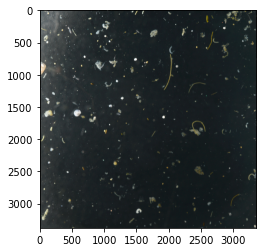

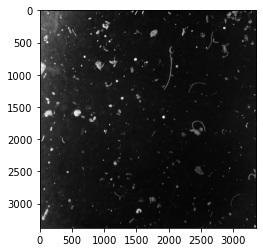

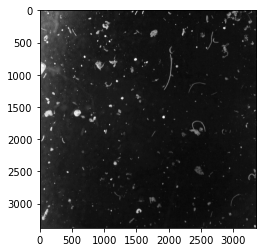

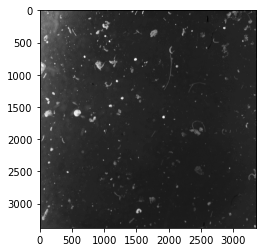

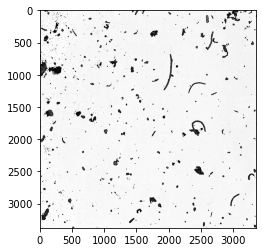

...

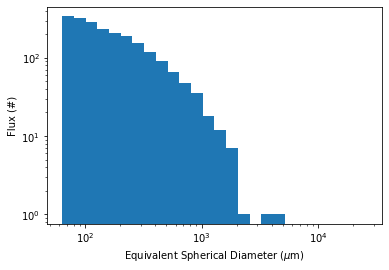

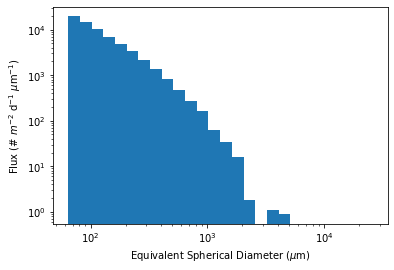

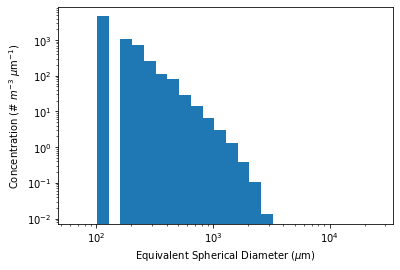

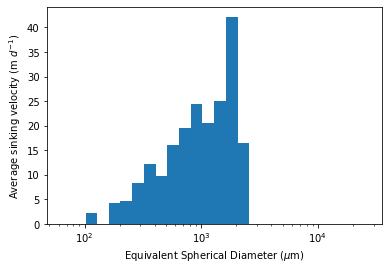

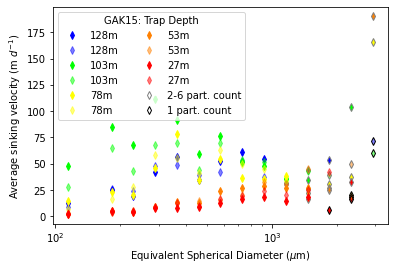

In [14]:
#from testing_gel_image_processing
#Just GAK15
import numpy as np
import pandas as pd
gels = [28, 29, 30, 31, 32, 33, 34, 35, 36, 37] #GAK15
sinking_vel_all=np.array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])
num_part=np.array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])
uvp_conc_all=np.array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.]) ####
flux_all=np.array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])#####
num_part_conc = np.array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])#####$$$$$$$
for gel_num in gels:
    photo_grey, photo_brown_nobg, photo_red, photo_blue, photo, SKQ201915s_Path_Python_str, SKQ201915s_Image_Number_Path_str, SKQ201915s_Station_Name_str, SKQ201915s_Tube_Number_str, SKQ201915s_cmperpixel_pixels_per_cm_num, SKQ201915s_mean_conc_50m_norm_num, SKQ201915s_Days_Collecting_num, SKQ201915s_Trap_depth_num, SKQ201915s_Num_Part_Conc_num = gel_image_processing(gel_num, gels)
    photo_grey_nobg = background_sub(photo_grey)
    markers_fill, labeled_particles, markers, labeled_edges, elevation_map_grey, edges= early_edge_detection(photo_grey_nobg, photo_brown_nobg, 8)
    check_thresholding(photo, markers_fill)
    #check_otsu(photo_grey, photo_grey_nobg, photo_brown_nobg, thresh)
    #~~~~~~~~~~~Devaiation- pre manual selection
    infocus_object_img, elevation_map_grey = id_and_match_infocus_edges(markers_fill, photo_grey_nobg)

    #~~~~~~~~~~~Devaiation- post manual selection
    #from skimage import io, filters, color, measure, util, morphology, exposure
    #import matplotlib.pyplot as plt
    #infocus_object_img2 = io.imread(f'D:/GIT/NGA_particles_flux_publication/Plots/SKQ201915S_{SKQ201915s_Station_Name_str[2:-2]}_{SKQ201915s_Tube_Number_str[2:-2]}_{SKQ201915s_Image_Number_Path_str[2:-2]}_in_focus_filt_reg_max_manual.png', as_gray=True).astype(int)
    #plt.figure()
    #plt.imshow(infocus_object_img2, cmap=plt.cm.gray)
    #infocus_object_img, elevation_map_grey = id_and_match_infocus_edges(infocus_object_img2, photo_grey_nobg)
    #~~~~~~~~~back to same script
    check_final_pixels(photo, infocus_object_img)
    data, scale = measure_count_part(SKQ201915s_Image_Number_Path_str, infocus_object_img, elevation_map_grey, SKQ201915s_cmperpixel_pixels_per_cm_num, 0)
    sinking_vel_all, size_bins_uvp, num_part, uvp_conc_all, flux_all, num_part_conc = plot_ESDs(photo, data, scale, SKQ201915s_Days_Collecting_num, SKQ201915s_mean_conc_50m_norm_num, sinking_vel_all, num_part, uvp_conc_all, flux_all, SKQ201915s_Num_Part_Conc_num, num_part_conc)#####$$$$$$$
sinking_vel = pd.DataFrame(sinking_vel_all)
sinking_vel.to_pickle(f"D:/GIT/NGA_particles_flux_publication/Data/SKQ201915S_{SKQ201915s_Station_Name_str[2:-2]}_sinking_vel_backgroundsub_edge_thresh.pkl") 
output = pd.read_pickle(f"D:/GIT/NGA_particles_flux_publication/Data/SKQ201915S_{SKQ201915s_Station_Name_str[2:-2]}_sinking_vel_backgroundsub_edge_thresh.pkl")####
uvp_conc = pd.DataFrame(uvp_conc_all)
uvp_conc.to_pickle(f"D:/GIT/NGA_particles_flux_publication/Data/SKQ201915S_{SKQ201915s_Station_Name_str[2:-2]}_uvp_conc_backgroundsub_edge_thresh.pkl")
flux = pd.DataFrame(flux_all)
flux.to_pickle(f"D:/GIT/NGA_particles_flux_publication/Data/SKQ201915S_{SKQ201915s_Station_Name_str[2:-2]}_flux_backgroundsub_edge_thresh.pkl")
num_part_all = pd.DataFrame(num_part)####
num_part_all.to_pickle(f"D:/GIT/NGA_particles_flux_publication/Data/SKQ201915S_{SKQ201915s_Station_Name_str[2:-2]}_num_part_backgroundsub_edge_thresh.pkl") #####
output_num = pd.read_pickle(f"D:/GIT/NGA_particles_flux_publication/Data/SKQ201915S_{SKQ201915s_Station_Name_str[2:-2]}_num_part_backgroundsub_edge_thresh.pkl")#####
num_part_conc_all = pd.DataFrame(num_part_conc)
num_part_conc_all.to_pickle(f"D:/GIT/NGA_particles_flux_publication/Data/SKQ201915S_{SKQ201915s_Station_Name_str[2:-2]}_SKQ201915s_Num_Part_Conc_num.pkl")
plot_esd_v_5(size_bins_uvp, gels, np.array(output), SKQ201915s_Trap_depth_num, SKQ201915s_Station_Name_str, output_num)
